<a href="https://colab.research.google.com/github/SenecaQAnderson/heart-disease-risk-factor-analysis/blob/main/Heart_Disease_Risk_Factor_Analysis_Colab_Version.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Data Pre-Processing

1) import the dataset. use various methods (such as .unique and .value_counts) to learn relevant information about the dataset.

2) convert features with two non-numerical values into 0s and 1s.

3) convert features with more than two non-numerical values into numerical values with a one-hot feature vector.

4) separate into train and test sets. The train and test sets should have equal ratios of "Has heart disease" to "does not have heart disease", so you will either have to manually do this or find a library that can ensure even distribution in the train/test split. sklearn's train_test_split may have a way to make this happen, or it may not.

By the end of this section, these variables should exist. The training and test sets must have equal ratios of the two classes (has heart disease & doesn't have heart disease):

X: pandas dataset, minus the feature indicating whether the person has heart disease

y: pandas dataset, but only with the feature indicating whether the person has heart disease

X_train: numpy array. Subset of X including 70% of samples

y_train: numpy array. Samples from y matching with the samples in X_train

X_test: numpy array. the other 30% of the samples.

y_test: numpy array. Samples from y matching with the samples in X_test.

In [ ]:
import pandas as pd

dataset_url = "https://raw.githubusercontent.com/MichaelMcGilvray/Health-And-Med-Group2/main/heart_2020_cleaned.csv"
df = pd.read_csv(dataset_url)

In [ ]:
import numpy as np

# Convert yes/no to 1/0
corrected_yes_no_data = { "HeartDisease" : {"No": 0, "Yes": 1},
                  "Smoking" : {"No": 0, "Yes": 1},
                  "AlcoholDrinking" : {"No": 0, "Yes": 1},
                  "Stroke" : {"No": 0, "Yes": 1},
                  "DiffWalking" : {"No": 0, "Yes": 1},
                  "PhysicalActivity" : {"No": 0, "Yes": 1},
                  "Asthma" : {"No": 0, "Yes": 1},
                  "KidneyDisease" : {"No": 0, "Yes": 1},
                  "SkinCancer" : {"No": 0, "Yes": 1} }

df = df.replace(corrected_yes_no_data)
heatmap_df= df


# Convert continuous data to a usable form
corrected_AgeCategory = { "18-24" : 0, "25-29" : 1, "30-34" : 2, "35-39" : 3, "40-44" : 4,
                          "45-49" : 5, "50-54" : 6, "55-59" : 7, "60-64" : 8, "65-69" : 8,
                          "70-74" : 10, "75-79" : 11, "80 or older" : 12 }
df = df.replace(corrected_AgeCategory)

corrected_Diabetic = { "No" : 0, "No, borderline diabetes" : 1, "Yes (during pregnancy)" : 2, "Yes" : 2 }
df = df.replace(corrected_Diabetic)

corrected_GenHealth = { "Poor" : 0, "Fair" : 1, "Good" : 2, "Very good" : 3, "Excellent" : 4 }
df = df.replace(corrected_GenHealth)


# Convert categorical data to 1/0 using one-hot encoding
# df = pd.get_dummies(df, columns=["GenHealth", "PhysicalHealth", "MentalHealth", "Sex", "AgeCategory", "Race", "Diabetic", "SleepTime"])
df = pd.get_dummies(df, columns=["Sex", "Race"])


# Formula Source: https://www.stackvidhya.com/how-to-normalize-data-between-0-and-1-range/
def normalize_zero_one(i):
  return (i - np.min(i)) / (np.max(i) - np.min(i))

# Convert continuous data to normalized scalar between 0 and 1
df["BMI"] = normalize_zero_one(df["BMI"])
df["AgeCategory"] = normalize_zero_one(df["AgeCategory"])
df["MentalHealth"] = normalize_zero_one(df["MentalHealth"])
df["PhysicalHealth"] = normalize_zero_one(df["PhysicalHealth"])
df["Diabetic"] = normalize_zero_one(df["Diabetic"])
df["GenHealth"] = normalize_zero_one(df["GenHealth"])
df["SleepTime"] = normalize_zero_one(df["SleepTime"])

In [ ]:
df

,HeartDisease,BMI,Smoking,AlcoholDrinking,Stroke,PhysicalHealth,MentalHealth,DiffWalking,AgeCategory,Diabetic,...,KidneyDisease,SkinCancer,Sex_Female,Sex_Male,Race_American Indian/Alaskan Native,Race_Asian,Race_Black,Race_Hispanic,Race_Other,Race_White
0,0,0.055294,1,0,0,0.100000,1.0,0,0.583333,1.0,...,0,1,1,0,0,0,0,0,0,1
1,0,0.100447,0,0,1,0.000000,0.0,0,1.000000,0.0,...,0,0,1,0,0,0,0,0,0,1
2,0,0.175782,1,0,0,0.666667,1.0,0,0.666667,1.0,...,0,0,0,1,0,0,0,0,0,1
3,0,0.147169,0,0,0,0.000000,0.0,0,0.916667,0.0,...,0,1,1,0,0,0,0,0,0,1
4,0,0.141132,0,0,0,0.933333,0.0,1,0.333333,0.0,...,0,0,1,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319790,1,0.185802,1,0,0,0.233333,0.0,1,0.666667,1.0,...,0,0,0,1,0,0,0,1,0,0
319791,0,0.215139,1,0,0,0.000000,0.0,0,0.250000,0.0,...,0,0,0,1,0,0,0,1,0,0
319792,0,0.147531,0,0,0,0.000000,0.0,0,0.416667,0.0,...,0,0,1,0,0,0,0,1,0,0
319793,0,0.250996,0,0,0,0.000000,0.0,0,0.083333,0.0,...,0,0,1,0,0,0,0,1,0,0


In [ ]:
# Split dataframe into X and y

# X: pandas dataset, minus the feature indicating whether the person has heart disease
X = df.drop(labels="HeartDisease", axis=1)

# y: pandas dataset, but only with the feature indicating whether the person has heart disease
y = pd.DataFrame(df["HeartDisease"])

In [ ]:
from sklearn.model_selection import train_test_split

# X_train: numpy array. Subset of X including 80% of samples
# y_train: numpy array. Samples from y matching with the samples in X_train
# X_test: numpy array. the other 20% of the samples.
# y_test: numpy array. Samples from y matching with the samples in X_test.
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size= 0.8, test_size=0.2, stratify=y["HeartDisease"])

In [ ]:
# Verify the ratio of has heart disease to doesn't have heart disease was maintained during split
print("Original dataset:")
print("Doesn't have heart disease: %f %%" %((df["HeartDisease"].value_counts()[0] / df.shape[0])*100))
print("Has heart disease: %f %%\n" %((df["HeartDisease"].value_counts()[1] / df.shape[0])*100))

print("After split -\ntrain set -")
print("Doesn't have heart disease: %f %%" %((y_train["HeartDisease"].value_counts()[0] / y_train.shape[0])*100))
print("Has heart disease: %f %%" %((y_train["HeartDisease"].value_counts()[1] / y_train.shape[0])*100))

print("\ntest -")
print("Doesn't have heart disease: %f %%" %((y_test["HeartDisease"].value_counts()[0] / y_test.shape[0])*100))
print("Has heart disease: %f %%" %((y_test["HeartDisease"].value_counts()[1] / y_test.shape[0])*100))

Original dataset:
Doesn't have heart disease: 91.440454 %
Has heart disease: 8.559546 %

After split -
train set -
Doesn't have heart disease: 91.440610 %
Has heart disease: 8.559390 %

test -
Doesn't have heart disease: 91.439829 %
Has heart disease: 8.560171 %


In [ ]:
# If the train and test sets need to be numpy arrays:
# X_train = X_train.to_numpy()
# X_test = X_test.to_numpy()
# y_train = y_train.to_numpy()
# y_test = y_test.to_numpy()

# Correlation Analysis

1) calculate Pearson correlation coefficients for X (not X_train or X_test) & display heat map

2) calculate Spearman correlation coefficients & display heat map

3) If a pair of variables has a very high positive or negative correlation, figure out which one is dependent (may require some research -- remember to save your sources so we can cite them) and drop the dependent variable from both the train and test sets.

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

Pearson Correlation Coefficient

In [ ]:
X_Coff = heatmap_df.corr()

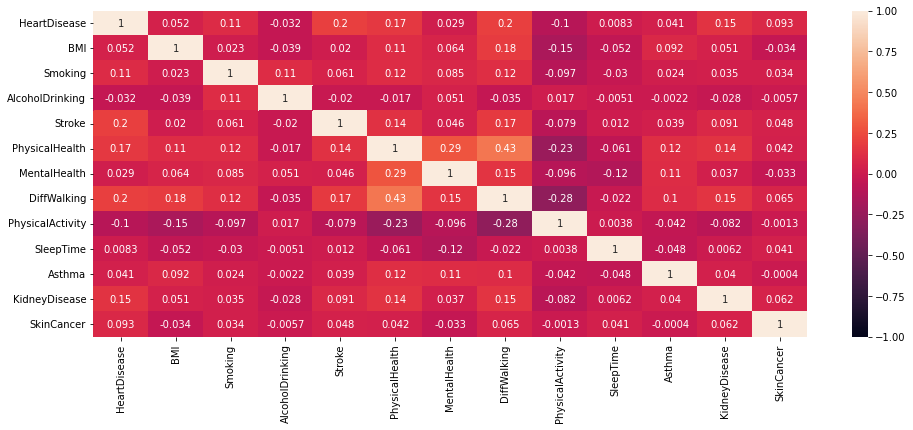

In [ ]:
plt.figure(figsize=(16, 6))

heatmap = sns.heatmap(X_Coff, vmin = -1, vmax = 1, annot=True)

Spearman's Correlation Coefficient

In [ ]:
X_Coff_spearman = heatmap_df.corr(method = "spearman")

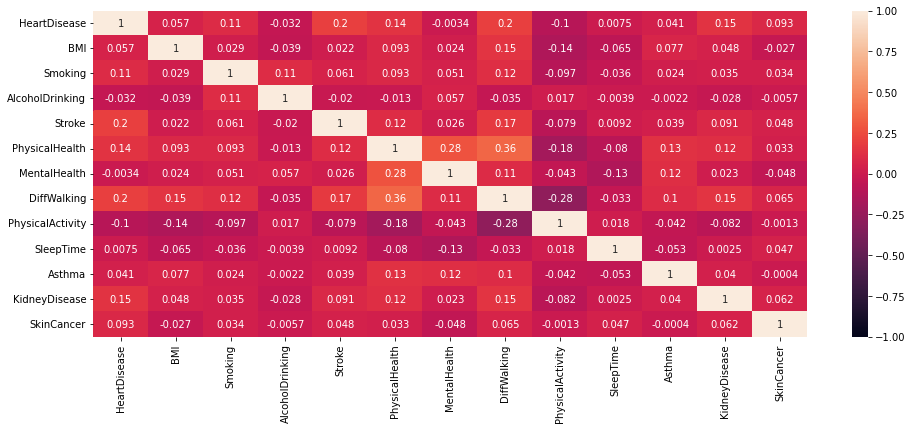

In [ ]:
plt.figure(figsize=(16, 6))

heatmap = sns.heatmap(X_Coff_spearman, vmin = -1, vmax = 1, annot=True)

# Classification

Run the following classification models on the data. Account for the severe data imbalance in whatever way is most effective. Show Recall, Accuracy, Precision, F1, AUC, ROC Curve, and Confusion Matrix for each one, ideallyl in a way that allows you to compare multiple classifiers at once. At the end, report the most accurate classifier, which will be used for Shapley value calculation.

In [ ]:
import time

from imblearn.over_sampling import RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from sklearn.metrics import accuracy_score, f1_score, roc_auc_score, recall_score, precision_score
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import classification_report

oversampler = RandomOverSampler()
undersampler = RandomUnderSampler()
samplers = {"raw data": None, 
            "oversampled": oversampler, 
            "undersampled": undersampler}

def print_scores(y_test, y_pred):
  print("Accuracy:", accuracy_score(y_test, y_pred))
  print("F1 score:", f1_score(y_test, y_pred))
  print("AUC ROC score:", roc_auc_score(y_test, y_pred))
  print("Recall:", recall_score(y_test, y_pred))
  print("Precision:", precision_score(y_test, y_pred))

def resample_fit_score(model, resampler, X_train, y_train, X_test, y_test):
    start = time.time()
    if resampler:
        resampled_train_data, resampled_train_label = resampler.fit_resample(X_train, y_train)
    else:
        resampled_train_data, resampled_train_label = X_train, y_train
    model = model.fit(resampled_train_data, resampled_train_label)
    end = time.time()
    print(f"Training time: {end-start}")
    y_pred = model.predict(X_test)
    print(classification_report(y_test, y_pred))
    print_scores(y_test, y_pred)

def run_all_samplers(model, samplers, X_train, y_train, X_test, y_test):
    for sampler_name in samplers:
      resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
      print(f"===============================")
      print(f"{sampler_name}\n\n")
      print(f"===============================")

import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
sns.set(style="white", color_codes=True)

def cm(y_test, y_predicted):
    cm = confusion_matrix(y_test, y_predicted)
    plt.figure(figsize=(15,10))
    plt.clf()
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Wistia)
    classNames = ['Negative','Positive']
    plt.title('Confusion Matrix')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    tick_marks = np.arange(len(classNames))
    plt.xticks(tick_marks, classNames, rotation=45)
    plt.yticks(tick_marks, classNames)
    s = [['TN','FP'], ['FN', 'TP']]
    
    for i in range(2):
        for j in range(2):
            plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))
    plt.show()

## Logistic Regression

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 22.659207820892334
              precision    recall  f1-score   support

           0       0.92      0.99      0.96     58484
           1       0.55      0.12      0.19      5475

    accuracy                           0.92     63959
   macro avg       0.74      0.55      0.57     63959
weighted avg       0.89      0.92      0.89     63959

Accuracy: 0.916180678247002
F1 score: 0.19152465691449255
AUC ROC score: 0.5535366578815296
Recall: 0.11598173515981736
Precision: 0.5493079584775087
raw data report




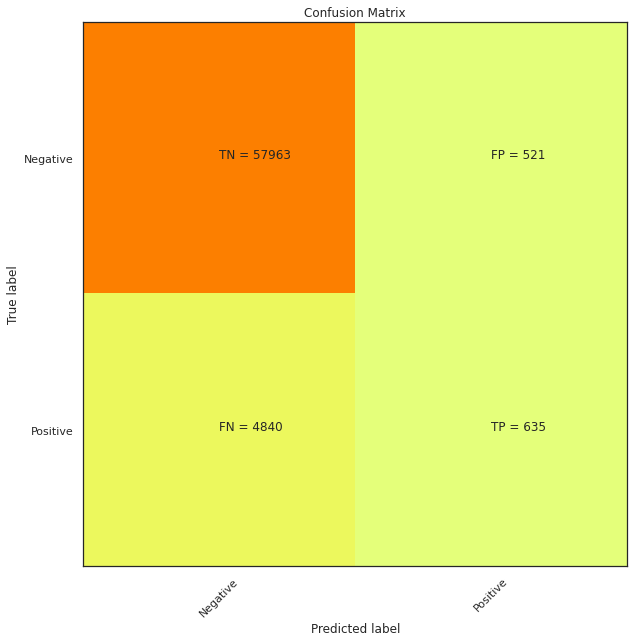

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 38.15847039222717
              precision    recall  f1-score   support

           0       0.97      0.75      0.85     58484
           1       0.23      0.78      0.35      5475

    accuracy                           0.76     63959
   macro avg       0.60      0.77      0.60     63959
weighted avg       0.91      0.76      0.81     63959

Accuracy: 0.7560155724761175
F1 score: 0.3543382018287889
AUC ROC score: 0.7678370417979519
Recall: 0.7821004566210046
Precision: 0.22905745158874505
oversampled report




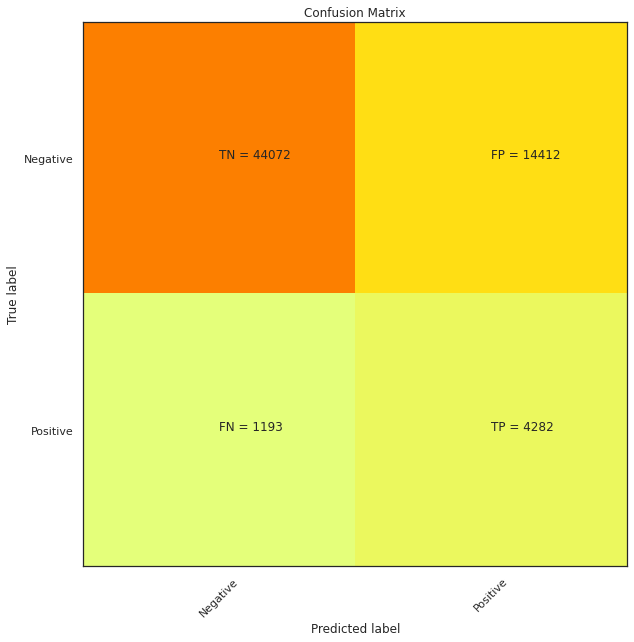

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 2.167198419570923
              precision    recall  f1-score   support

           0       0.97      0.75      0.85     58484
           1       0.23      0.78      0.35      5475

    accuracy                           0.75     63959
   macro avg       0.60      0.77      0.60     63959
weighted avg       0.91      0.75      0.81     63959

Accuracy: 0.7548742162948139
F1 score: 0.35364445910290243
AUC ROC score: 0.7677923634579524
Recall: 0.78337899543379
Precision: 0.2283690964272403
undersampled report




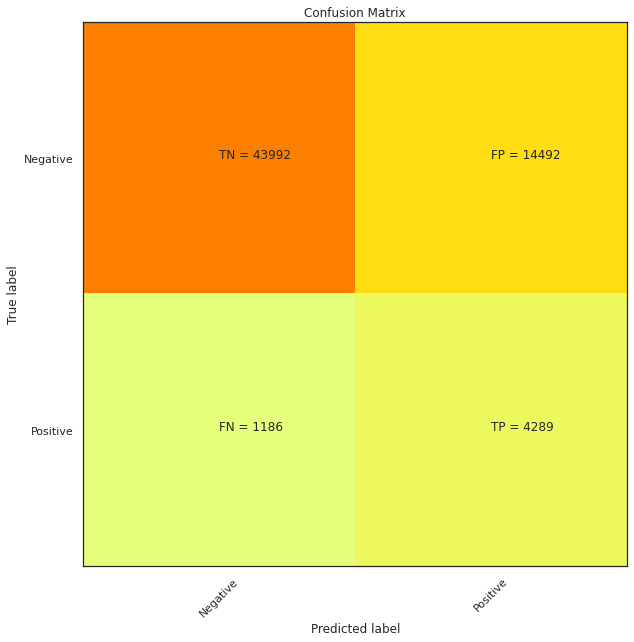

In [ ]:
from sklearn.linear_model import LogisticRegression

# If time allows you to run this the rest of this by uncommenting
# Grid search over hyperparams
# parameter_grid = {'penalty' : ["l2"],'C': np.arange(0, 3, 1),}
# model = GridSearchCV(model, param_grid = parameter_grid, scoring='roc_auc', n_jobs=10, cv=2, verbose=2.2)

for sampler_name in samplers:
    model = LogisticRegression(solver='saga')
    resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"{sampler_name} report\n\n")
    y_pred = model.predict(X_test)
    cm(y_test, y_pred)

## SVC-Linear

In [ ]:
from sklearn.svm import LinearSVC

model = LinearSVC(verbose=0)

for sampler_name in samplers:
    resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"{sampler_name}\n\n")

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 15.995983362197876
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     58484
           1       0.58      0.04      0.08      5475

    accuracy                           0.92     63959
   macro avg       0.75      0.52      0.52     63959
weighted avg       0.89      0.92      0.88     63959

Accuracy: 0.9153676574055254
F1 score: 0.07706734867860188
AUC ROC score: 0.5192371765262888
Recall: 0.04127853881278539
Precision: 0.5794871794871795
raw data




/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 47.12018084526062
              precision    recall  f1-score   support

           0       0.97      0.74      0.84     58484
           1       0.22      0.78      0.35      5475

    accuracy                           0.75     63959
   macro avg       0.60      0.76      0.59     63959
weighted avg       0.91      0.75      0.80     63959

Accuracy: 0.7475257586891603
F1 score: 0.34575804229803103
AUC ROC score: 0.7619531236580649
Recall: 0.7793607305936073
Precision: 0.22215858801478627
oversampled




/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 1.520240306854248
              precision    recall  f1-score   support

           0       0.97      0.74      0.84     58484
           1       0.22      0.78      0.35      5475

    accuracy                           0.75     63959
   macro avg       0.60      0.76      0.59     63959
weighted avg       0.91      0.75      0.80     63959

Accuracy: 0.7476508388186182
F1 score: 0.34597617310965234
AUC ROC score: 0.7621870681408707
Recall: 0.7797260273972603
Precision: 0.22230901421652866
undersampled




## SVM-rbf Kernel

In [ ]:
# Scrapped because it takes too much time

# from sklearn.svm import SVC

# model = SVC(kernel='rbf', random_state=0, gamma=10, C=1)

# for sampler_name in samplers:
  
#     resample_fit_score(model, samplers[sampler_name], X_train, y_train, X_test, y_test)
#     print(f"{sampler_name}\n\n")

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


## XGBoost

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_bagging.py:719: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 72.20921206474304
              precision    recall  f1-score   support

           0       0.91      1.00      0.96     58484
           1       0.29      0.00      0.00      5475

    accuracy                           0.91     63959
   macro avg       0.60      0.50      0.48     63959
weighted avg       0.86      0.91      0.87     63959

Accuracy: 0.9142888412889507
F1 score: 0.0018208302986161692
AUC ROC score: 0.5003540288426074
Recall: 0.0009132420091324201
Precision: 0.29411764705882354
bagging classifier raw data




/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 20.940124988555908
              precision    recall  f1-score   support

           0       0.92      0.99      0.96     58484
           1       0.58      0.08      0.14      5475

    accuracy                           0.92     63959
   macro avg       0.75      0.54      0.55     63959
weighted avg       0.89      0.92      0.89     63959

Accuracy: 0.9162901233602777
F1 score: 0.13728649693844663
AUC ROC score: 0.536296558805921
Recall: 0.07780821917808219
Precision: 0.5827633378932968
xgb raw data




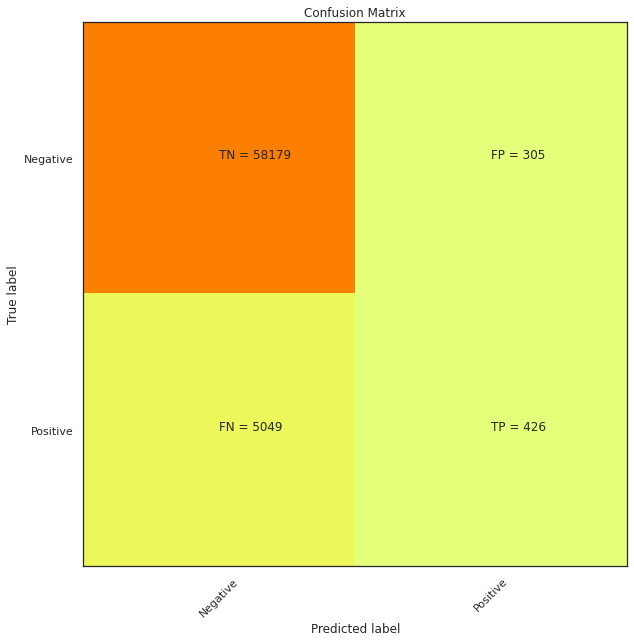

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_bagging.py:719: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 203.20757579803467
              precision    recall  f1-score   support

           0       0.97      0.75      0.85     58484
           1       0.22      0.74      0.34      5475

    accuracy                           0.75     63959
   macro avg       0.59      0.75      0.59     63959
weighted avg       0.90      0.75      0.80     63959

Accuracy: 0.7496521208899452
F1 score: 0.33587722936540854
AUC ROC score: 0.7450709166367635
Recall: 0.7395433789954338
Precision: 0.21727931312047222
bagging classifier oversampled




/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 39.68173813819885
              precision    recall  f1-score   support

           0       0.98      0.73      0.84     58484
           1       0.22      0.81      0.35      5475

    accuracy                           0.74     63959
   macro avg       0.60      0.77      0.59     63959
weighted avg       0.91      0.74      0.79     63959

Accuracy: 0.7371753779765162
F1 score: 0.3459143968871595
AUC ROC score: 0.7710273800835041
Recall: 0.8118721461187215
Precision: 0.21977750309023486
xgb oversampled




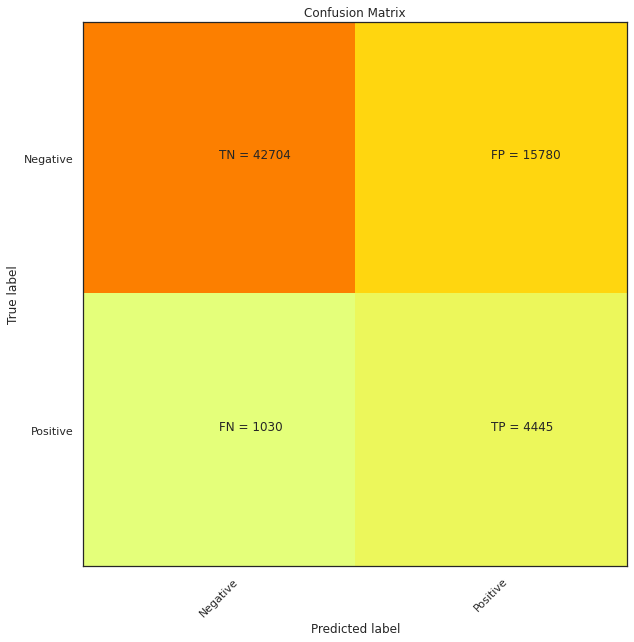

/usr/local/lib/python3.7/dist-packages/sklearn/ensemble/_bagging.py:719: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 16.352466344833374
              precision    recall  f1-score   support

           0       0.97      0.69      0.80     58484
           1       0.18      0.75      0.29      5475

    accuracy                           0.69     63959
   macro avg       0.58      0.72      0.55     63959
weighted avg       0.90      0.69      0.76     63959

Accuracy: 0.6928344720836787
F1 score: 0.2943754040657999
AUC ROC score: 0.7180585581069825
Recall: 0.7484931506849315
Precision: 0.1832163455090088
bagging classifier undersampled




/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:98: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/preprocessing/_label.py:133: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 3.2607295513153076
              precision    recall  f1-score   support

           0       0.98      0.73      0.83     58484
           1       0.22      0.82      0.34      5475

    accuracy                           0.73     63959
   macro avg       0.60      0.77      0.59     63959
weighted avg       0.91      0.73      0.79     63959

Accuracy: 0.73315717881768
F1 score: 0.3440058423338586
AUC ROC score: 0.7713134435707194
Recall: 0.817351598173516
Precision: 0.21784636354785317
xgb undersampled




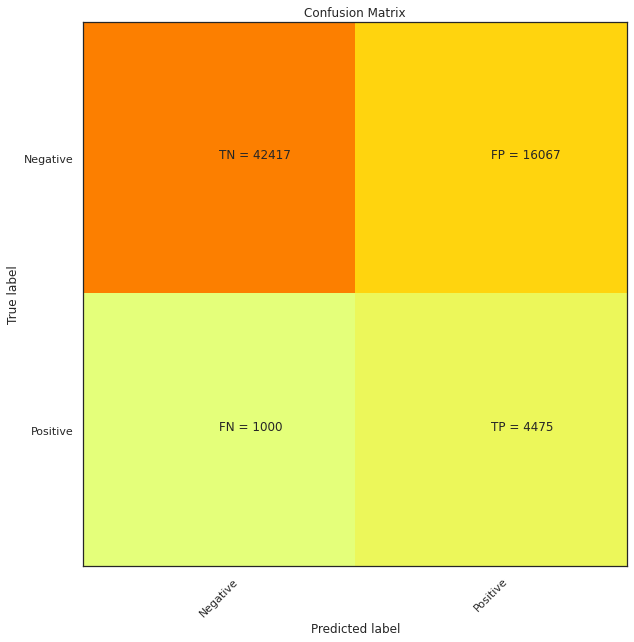

In [ ]:
import xgboost as xgb
from sklearn.ensemble import BaggingClassifier

for sampler_name in samplers:
    xgb_classifier = xgb.XGBClassifier()
    bagging = BaggingClassifier(base_estimator=xgb_classifier, n_estimators=5, max_samples=50, bootstrap=True)
    
    resample_fit_score(bagging, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"bagging classifier {sampler_name}\n\n")
    
    resample_fit_score(xgb_classifier, samplers[sampler_name], X_train, y_train, X_test, y_test)
    print(f"xgb {sampler_name}\n\n")
    y_pred = xgb_classifier.predict(X_test)
    cm(y_test, y_pred)

## Neural Network (MLP)

In [ ]:
%%time

from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV

# mlp = MLPClassifier(random_state=1111, max_iter=100, hidden_layer_sizes=(200, 100)).fit(X_train, y_train)
# y_pred = mlp.predict(X_test)
# print(print_scores(y_test, y_pred))

model = MLPClassifier(max_iter=100)

# parameter_space = {
#     'hidden_layer_sizes': [(100,200,50),(100,20)],
#     'activation': ['tanh', 'relu'],
#     'solver': ['sgd', 'adam'],
#     'alpha': [0.0001, 0.05],
#     'learning_rate': ['constant','adaptive'],
# }
# gs = GridSearchCV(mlp, parameter_space, n_jobs=-1, cv=2, verbose=3)
# gs.fit(X_train, y_train)
# print('Best params: {}'.format(gs.best_params_)) 
# print('Best Score: {}'.format(gs.best_score_))

resample_fit_score(model, samplers['undersampled'], X_train, y_train, X_test, y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:1109: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
/usr/local/lib/python3.7/dist-packages/sklearn/neural_network/_multilayer_perceptron.py:696: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  ConvergenceWarning,


Training time: 431.6128752231598
              precision    recall  f1-score   support

           0       0.98      0.72      0.83     58484
           1       0.21      0.81      0.33      5475

    accuracy                           0.72     63959
   macro avg       0.59      0.76      0.58     63959
weighted avg       0.91      0.72      0.78     63959

Accuracy: 0.7233071186228678
F1 score: 0.33311979500320305
AUC ROC score: 0.7613747380932973
Recall: 0.8073059360730593
Precision: 0.20985661380685594
CPU times: user 10min, sys: 17min 55s, total: 27min 55s
Wall time: 7min 11s


# kNN

In [ ]:
%%time

from sklearn.neighbors import KNeighborsClassifier
 
model = KNeighborsClassifier(n_neighbors=8)
# model.fit(X_train, y_train)
# y_pred = model.predict(X_test)
# print_scores(y_test, y_pred)

resample_fit_score(model, samplers['undersampled'], X_train, y_train, X_test, y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/neighbors/_classification.py:198: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return self._fit(X, y)


Training time: 0.5036470890045166
              precision    recall  f1-score   support

           0       0.95      0.79      0.86     58484
           1       0.20      0.57      0.30      5475

    accuracy                           0.77     63959
   macro avg       0.58      0.68      0.58     63959
weighted avg       0.89      0.77      0.82     63959

Accuracy: 0.7720101940305508
F1 score: 0.3012267586735672
AUC ROC score: 0.6823024648040178
Recall: 0.5740639269406392
Precision: 0.2041837198726694
CPU times: user 11min 57s, sys: 1min 23s, total: 13min 21s
Wall time: 9min 14s


## Decision Tree Classifier with Bagging


In [ ]:
%%time

from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import BaggingClassifier

tree = DecisionTreeClassifier(max_depth=3, random_state=1111)
bagging = BaggingClassifier(base_estimator=tree, 
                            n_estimators=5, 
                            max_samples=50, 
                            bootstrap=True)

resample_fit_score(bagging, samplers['undersampled'], X_train, y_train, X_test, y_test)
print("Bagging Classifier\n\n")

print(f"Train score: {bagging.score(X_train, y_train)}")
print(f"Test score: {bagging.score(X_test, y_test)}")

resample_fit_score(tree, samplers['undersampled'], X_train, y_train, X_test, y_test)
print("Decision Tree Classifier with Bagging\n\n")

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().


Training time: 0.18298816680908203
              precision    recall  f1-score   support

           0       0.96      0.73      0.83     58484
           1       0.19      0.68      0.30      5475

    accuracy                           0.72     63959
   macro avg       0.57      0.70      0.56     63959
weighted avg       0.89      0.72      0.78     63959

Accuracy: 0.72332275363905
F1 score: 0.29598981540420116
AUC ROC score: 0.7034408895817892
Recall: 0.6794520547945205
Precision: 0.18920705966125834
Bagging Classifier


Train score: 0.7212784752732219
Test score: 0.72332275363905
Training time: 0.16038203239440918
              precision    recall  f1-score   support

           0       0.98      0.63      0.77     58484
           1       0.18      0.84      0.29      5475

    accuracy                           0.65     63959
   macro avg       0.58      0.74      0.53     63959
weighted avg       0.91      0.65      0.73     63959

Accuracy: 0.6482746759642897
F1 score: 0.2912

## Decision Tree Classifier with Boosting


In [ ]:
%%time
from sklearn.tree import DecisionTreeClassifier 
from sklearn.ensemble import AdaBoostClassifier

tree = DecisionTreeClassifier(max_depth=2, random_state=1111)

adaboost = AdaBoostClassifier(base_estimator=tree,
                              n_estimators=5, 
                              learning_rate=0.1, 
                              random_state=23)

resample_fit_score(adaboost, samplers['undersampled'], X_train, y_train, X_test, y_test)

# Train Decision Tree Classifer
tree = tree.fit(X_train,y_train)

resample_fit_score(tree, samplers['undersampled'], X_train, y_train, X_test, y_test)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/validation.py:993: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Training time: 0.3672623634338379
              precision    recall  f1-score   support

           0       0.96      0.76      0.85     58484
           1       0.21      0.68      0.32      5475

    accuracy                           0.75     63959
   macro avg       0.58      0.72      0.58     63959
weighted avg       0.90      0.75      0.80     63959

Accuracy: 0.7489485451617443
F1 score: 0.3180872297957277
AUC ROC score: 0.7195226403880826
Recall: 0.6840182648401827
Precision: 0.20722664895971668
Training time: 0.1376948356628418
              precision    recall  f1-score   support

           0       0.96      0.72      0.83     58484
           1       0.19      0.71      0.30      5475

    accuracy                           0.72     63959
   macro avg       0.58      0.72      0.56     63959
weighted avg       0.90      0.72      0.78     63959

Accuracy: 0.7217436170046436
F1 score: 0.30341696348193664
AUC ROC score: 0.7154902827889702
Recall: 0.707945205479452
Precision

## Random Forest Classifier

In [ ]:
#grid search
from sklearn.ensemble import RandomForestClassifier

for sampler in samplers:
    parameters = {  
        'n_estimators': [24,28,32],   
        'max_features': ('sqrt','log2','auto'), 
        'max_depth':    (5,10,15),     
        'criterion'   : ['gini', 'entropy'],
    }
    model = RandomForestClassifier()
    gs = GridSearchCV(estimator = model,     
                              param_grid = parameters, 
                              cv = 2,
                              n_jobs = -1,
                              return_train_score = False,
                              scoring = "accuracy"      
                            )

    resample_fit_score(gs, samplers[sampler], X_train, y_train, X_test, y_test)
    print("Grid Search Random Forest\n\n")

# print('Best params: {}'.format(gs.best_params_)) 
# print('Best Score: {}'.format(gs.best_score_))


A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


Training time: 253.0341339111328
              precision    recall  f1-score   support

           0       0.92      1.00      0.96     58484
           1       0.63      0.04      0.07      5475

    accuracy                           0.92     63959
   macro avg       0.77      0.52      0.51     63959
weighted avg       0.89      0.92      0.88     63959

Accuracy: 0.915727262777717
F1 score: 0.07068965517241378
AUC ROC score: 0.5176955395676264
Recall: 0.03744292237442922
Precision: 0.6307692307692307
Grid Search Random Forest




A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


Training time: 515.1948697566986
              precision    recall  f1-score   support

           0       0.97      0.78      0.86     58484
           1       0.23      0.72      0.35      5475

    accuracy                           0.78     63959
   macro avg       0.60      0.75      0.61     63959
weighted avg       0.90      0.78      0.82     63959

Accuracy: 0.7756218827686486
F1 score: 0.35387870874791766
AUC ROC score: 0.7494211740853136
Recall: 0.7178082191780822
Precision: 0.23482313575525812
Grid Search Random Forest




A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


Training time: 43.11961388587952
              precision    recall  f1-score   support

           0       0.98      0.71      0.82     58484
           1       0.21      0.83      0.33      5475

    accuracy                           0.72     63959
   macro avg       0.59      0.77      0.58     63959
weighted avg       0.91      0.72      0.78     63959

Accuracy: 0.7189605841242046
F1 score: 0.33492433492433493
AUC ROC score: 0.7677721542074185
Recall: 0.8266666666666667
Precision: 0.21000371195248702
Grid Search Random Forest




# Shapley Value Calculation

Calculate the Shapley values for the most accurate classifier, implementing whatever methods are necessary to ensure that this process finishes in a reasonable amount of time.

In [ ]:
!pip install shap
import shap
from datetime import datetime

In [ ]:
xgb_explr = shap.Explainer(xgb_classifier)
xgb_shap_values = xgb_explr(X)

In [ ]:
k = 500
rfc_explr = shap.Explainer(gs.predict, shap.sample(X_train, k))
rfc_shap_vals = rfc_explr(shap.sample(X_test, k))

Permutation explainer: 501it [01:34,  4.73it/s]


In [ ]:
dec_tree_explr = shap.Explainer(bagging.predict, shap.sample(X_train, k))
dec_tree_shap_vals = dec_tree_explr(shap.sample(X_test, k))

Permutation explainer: 501it [00:36,  9.67it/s]                         


# Final Analysis & Data Visualizations

Generate all remaining data visualizations, graphs, etc. with the combined results of the correlation analysis and Shapley values. Generate whatever visualizations may be necessary or helpful for both our presentation and invidual rports. Err on the side of too many. Draw conclusions from the visualizations & write them down here.

In [ ]:
# xgb_shap_values
# rfc_shap_vals
# dec_tree_shap_values

shap_vals = [xgb_shap_values, rfc_shap_vals, dec_tree_shap_vals]

In [ ]:
for shaps in shap_vals:
  print(type(shaps))

<class 'shap._explanation.Explanation'>
<class 'shap._explanation.Explanation'>
<class 'shap._explanation.Explanation'>


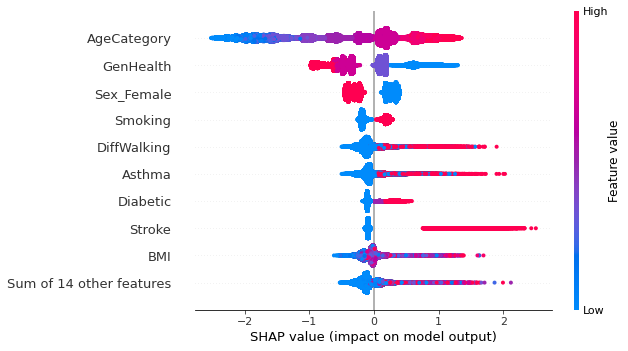

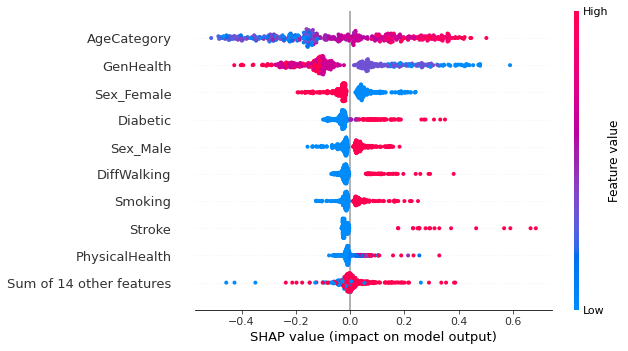

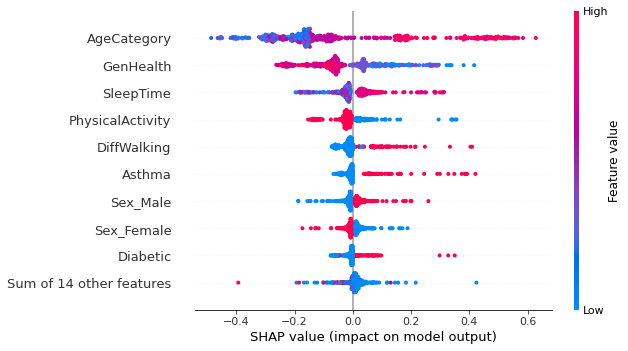

In [ ]:
for shaps in shap_vals:
  shap.plots.beeswarm(shaps)

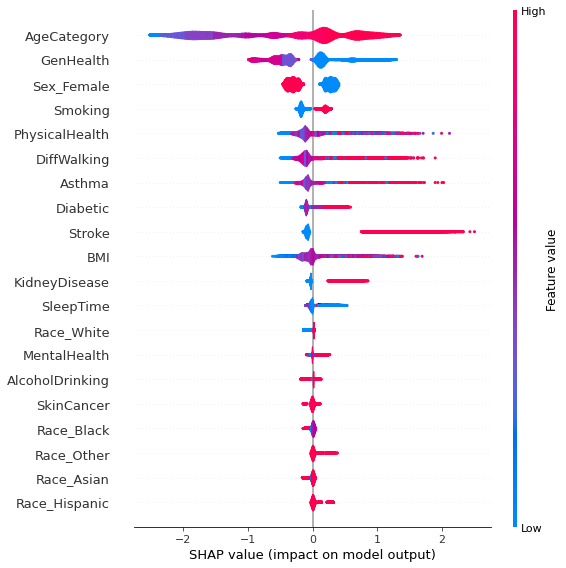

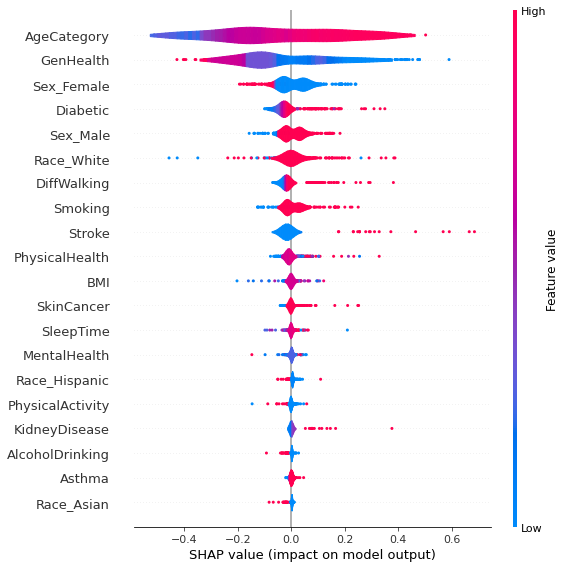

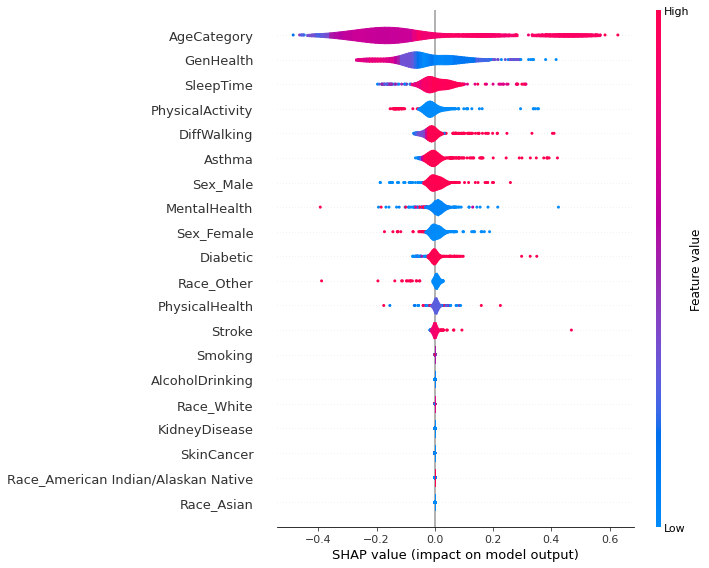

In [ ]:
for shaps in shap_vals:
  shap.summary_plot(shaps, plot_type="violin")

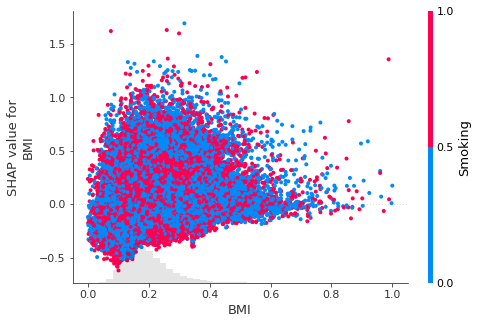

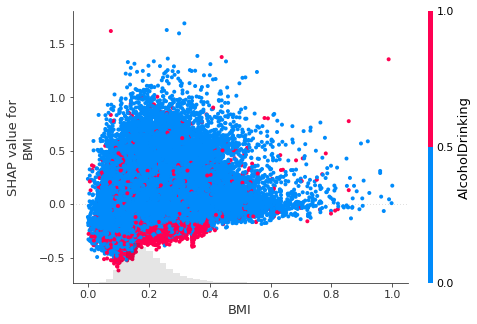

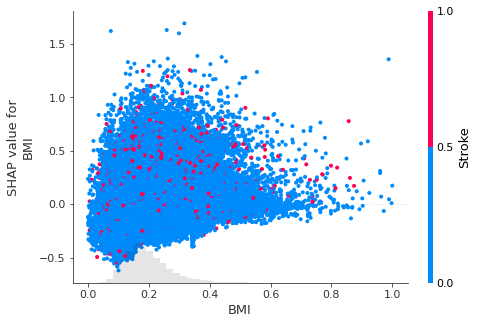

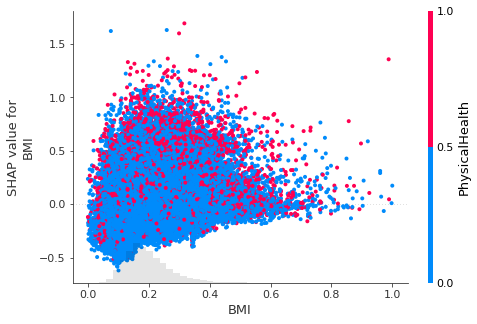

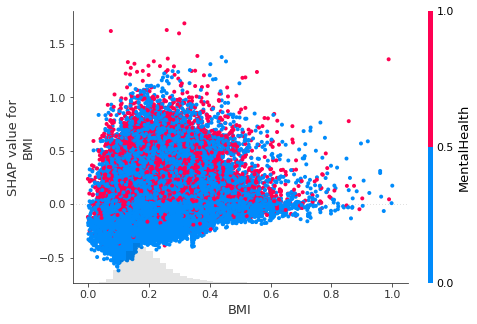

...

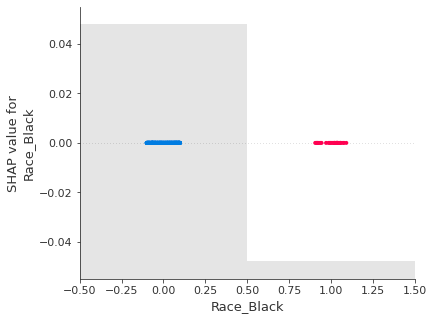

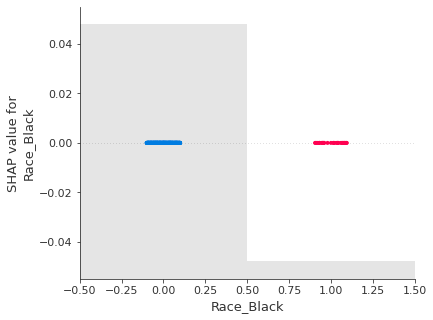

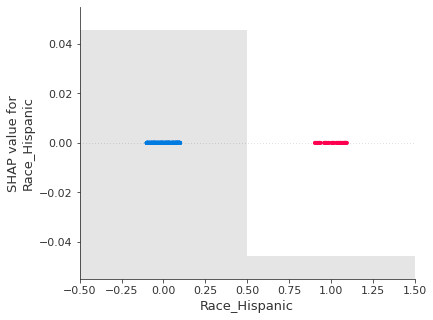

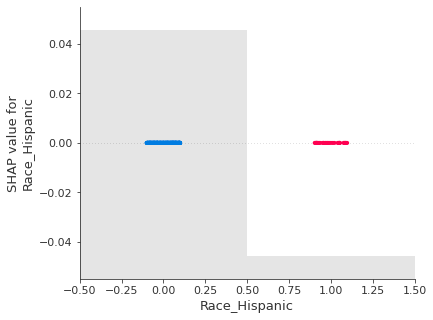

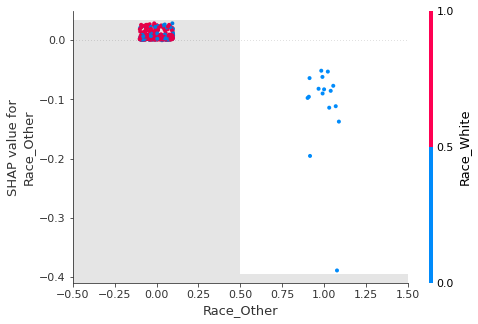

In [ ]:
for shaps in shap_vals:
  names = shaps.feature_names
  for k in range(0, len(names)):
      for j in range(k, len(names)):
        if(names[k] != names[j]):
          shap.plots.scatter(shaps[:, names[k]], color=shaps[:, names[j]])